### Kinker G. S., et al Nat Genet
- Kinker, G.S., Greenwald, A.C., Tal, R. et al. Pan-cancer single-cell RNA-seq identifies recurring programs of cellular heterogeneity. Nat Genet 52, 1208–1218 (2020). https://doi.org/10.1038/s41588-020-00726-6
- GEO: GSE157220
- Cell lines of pan-cancer (198 cancer cell lines from 22 cancer types, Homo sapiens)
- Illumina NextSeq 500

In [1]:
import os
import sys
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
# import scanorama
import anndata as an
from scipy.sparse import csr_matrix
from deside.single_cell import get_10x_mtx, normalize_mtx
from deside.utility import non_log2cpm
# sns.set()

### 1. Filtering raw data

In [2]:
file_path = r'../datasets/single_cell/Pan_cancer_cell_lines/'
result_dir = os.path.join(file_path, 'preprocessing')

In [3]:
tpm = pd.read_csv(os.path.join(file_path, 'GSE157220_CPM_data.txt'), sep='\t', index_col=0)
tpm = tpm.T
print(tpm.shape)
tpm.head(2)

(53513, 22722)


GENE,RP11-34P13.7,AP006222.2,RP4-669L17.10,RP4-669L17.2,RP5-857K21.2,RP5-857K21.4,RP11-206L10.9,FAM87B,LINC00115,FAM41C,...,MT-ND3,MT-ND4L,MT-ND4,MT-ND5,MT-ND6,MT-CYB,MGC39584,AC011043.1,AL592183.1,AL354822.1
AAACCTGAGACATAAC-1-18,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,841.957551,35.081565,4315.032450,526.223470,420.978776,2736.362042,0.0,0.0,0.0,0.0
AACGTTGTCACCCGAG-1-18,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,963.228743,48.161437,4503.094372,409.372216,361.210779,2191.345390,0.0,0.0,0.0,0.0


(array([1.0000e+00, 0.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00,
        7.0000e+00, 4.0000e+01, 1.0800e+02, 2.9200e+03, 5.0436e+04]),
 array([904818.84491211, 913976.01164125, 923133.17837039, 932290.34509953,
        941447.51182867, 950604.67855781, 959761.84528695, 968919.01201609,
        978076.17874523, 987233.34547437, 996390.51220351]),
 <BarContainer object of 10 artists>)

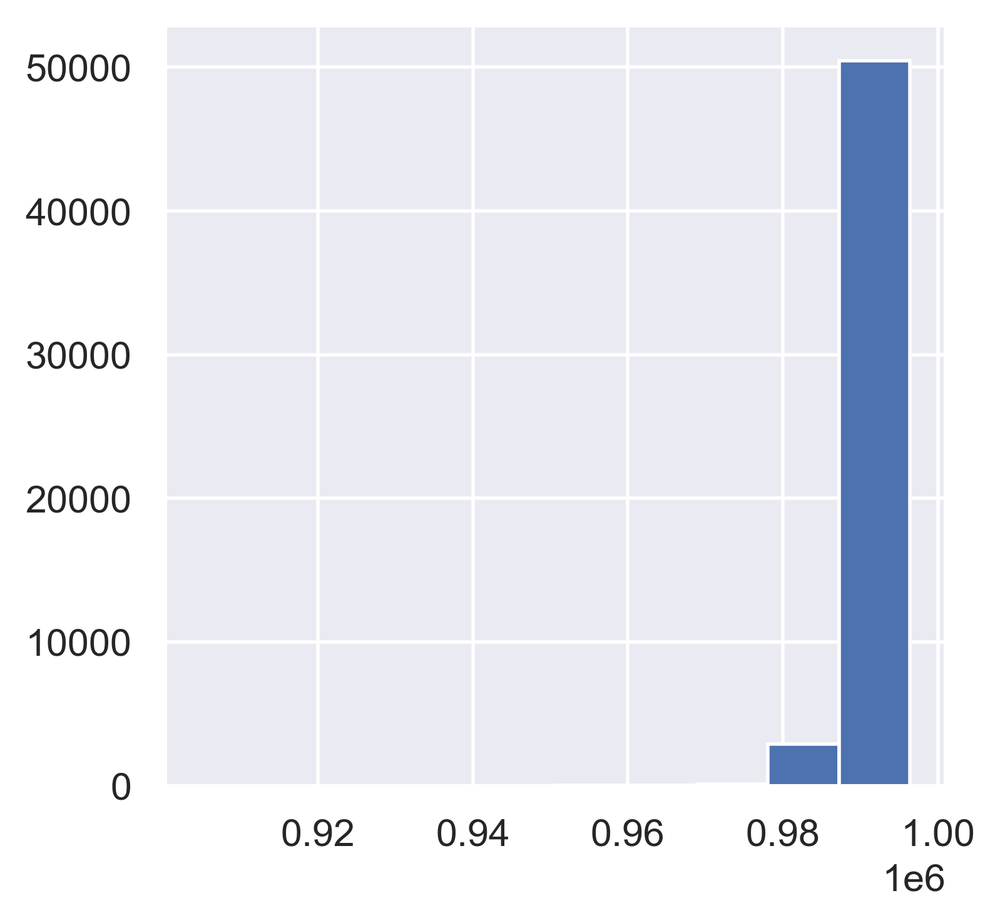

In [4]:
plt.hist(tpm.sum(axis=1))

In [5]:
tpm = non_log2cpm(tpm)
np.all((tpm.sum(axis=1) >= 1e6-1) & (tpm.sum(axis=1) <= 1e6+1))  # dobule check TPM

True

In [6]:
tpm = tpm.loc[:, tpm.columns.isna()==False]
tpm.shape

(53513, 22722)

In [7]:
gene_list_in_6_sc_dataset = pd.read_csv('../datasets/single_cell/gene_list_in_merged_6_sc_datasets.csv', index_col=0)
gene_list_in_6_sc_dataset.head(2)

,gene_ids
gene_name,
A1BG,ENSG00000121410
A2M,ENSG00000175899


In [8]:
gene_list_in_6_sc_dataset.shape

(12114, 1)

In [9]:
gene_not_in_current_dataset = [i for i in gene_list_in_6_sc_dataset.index if i not in tpm.columns]
len(gene_not_in_current_dataset)

151

In [10]:
# add 0 for genes not in other single cell datasets
for gene_name in gene_not_in_current_dataset:
    tpm[gene_name] = 0

In [11]:
adata = an.AnnData(tpm)
adata.X = csr_matrix(adata.X)
adata

/Users/belter/miniconda3/envs/deside/lib/python3.8/site-packages/anndata/utils.py:141: UserWarning: X converted to numpy array with dtype float64
  warnings.warn(f"{name} converted to numpy array with dtype {arr.dtype}")


AnnData object with n_obs × n_vars = 53513 × 22873

In [12]:
adata.X

<53513x22873 sparse matrix of type '<class 'numpy.float32'>'
	with 200825166 stored elements in Compressed Sparse Row format>

In [13]:
adata.obs['cell_type'] = 'Cancer Cells'
adata.obs['dataset_id'] = 'pan_cancer_07'
adata

AnnData object with n_obs × n_vars = 53513 × 22873
    obs: 'cell_type', 'dataset_id'

In [14]:
adata.obs

,cell_type,dataset_id
AAACCTGAGACATAAC-1-18,Cancer Cells,pan_cancer_07
AACGTTGTCACCCGAG-1-18,Cancer Cells,pan_cancer_07
AACTGGTAGACACGAC-1-18,Cancer Cells,pan_cancer_07
AACTGGTAGGGCTTGA-1-18,Cancer Cells,pan_cancer_07
AACTGGTAGTACTTGC-1-18,Cancer Cells,pan_cancer_07
...,...,...
c4722,Cancer Cells,pan_cancer_07
c4724,Cancer Cells,pan_cancer_07
c4731,Cancer Cells,pan_cancer_07
c4735,Cancer Cells,pan_cancer_07


In [15]:
adata.write(os.path.join(file_path, 'GSE157220_CPM_raw_before_filtering.h5ad'))

... storing 'cell_type' as categorical
... storing 'dataset_id' as categorical


In [18]:
adata = sc.read_h5ad(os.path.join(file_path, 'GSE157220_CPM_raw_before_filtering.h5ad'))
adata

AnnData object with n_obs × n_vars = 53513 × 22873
    obs: 'cell_type', 'dataset_id'

   The shape of adata before filtering is: (53513, 22873)


<Figure size 3000x600 with 0 Axes>

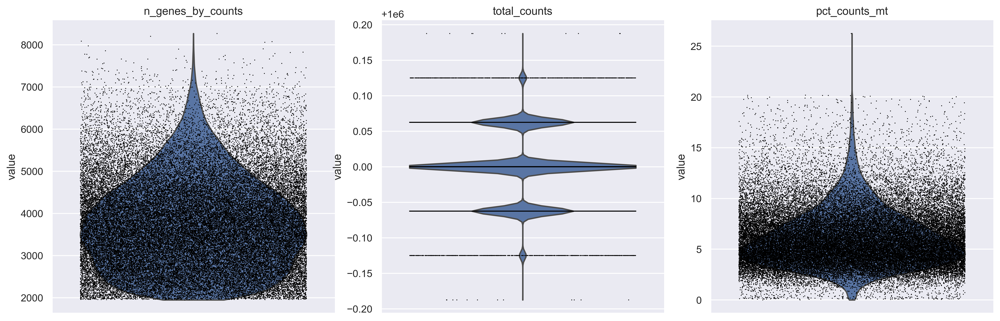

<Figure size 1600x1200 with 0 Axes>

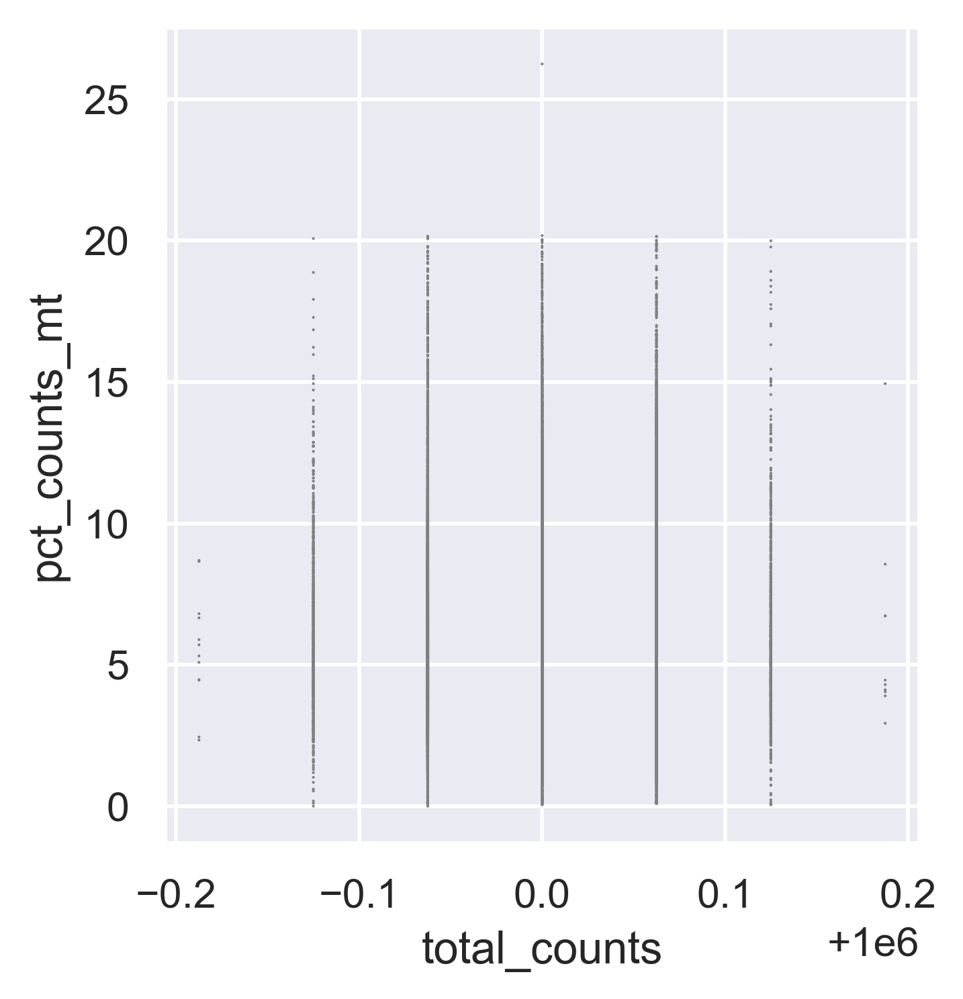

<Figure size 1600x1200 with 0 Axes>

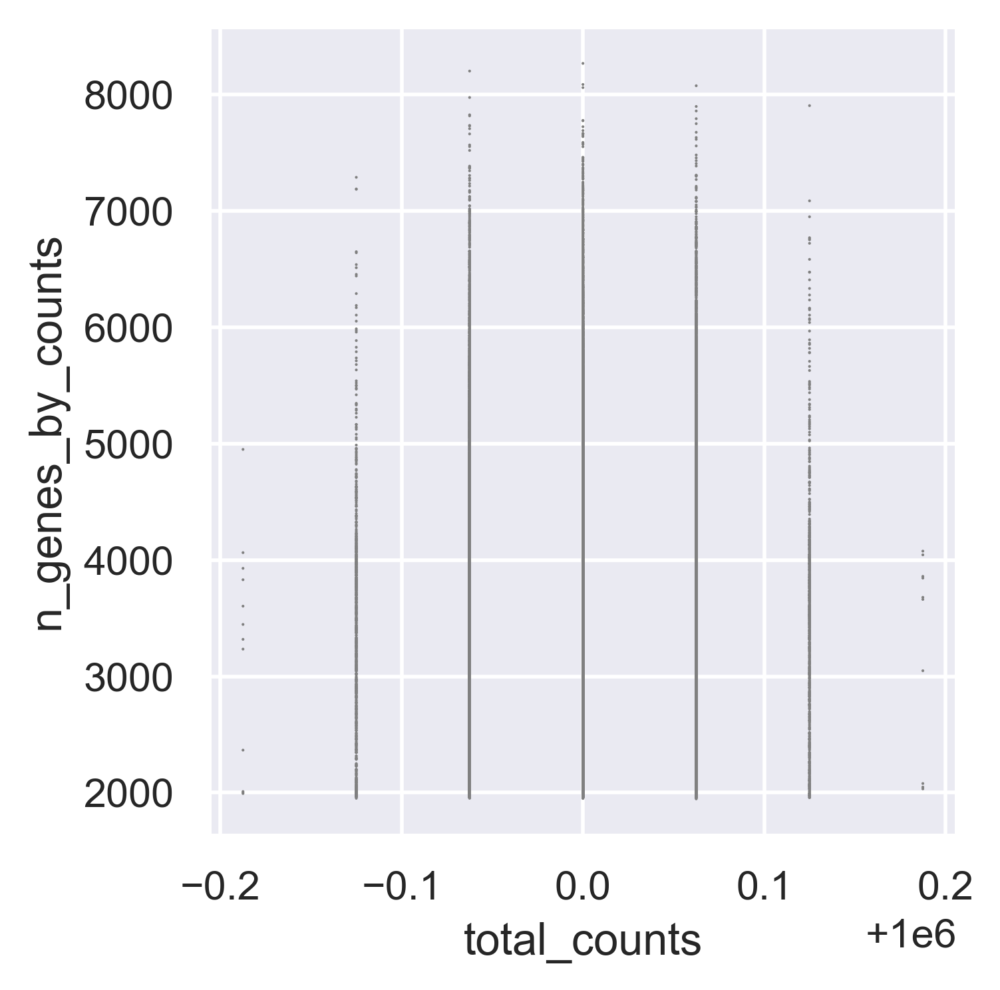

/Users/belter/miniconda3/envs/deside/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (47008, 22873)


In [19]:
sample_normalized = normalize_mtx(adata=adata, result_dir=result_dir, prefix='', fig_prefix='GSE157220_CPM', max_n_genes_by_counts=6000,
                                        max_pct_counts_mt=10, max_total_counts=1e6+1, log_base=2, filter_genes=False, target_sum=1e6, min_cells=3)
sample_normalized.write(os.path.join(result_dir, 'GSE157220_log2cpm1p_filtered.h5ad'))

#### Filter genes by annotation file
- only keep genes in other 6 datasets

In [20]:
all_dataset = sample_normalized[:, sample_normalized.var.index.isin(gene_list_in_6_sc_dataset.index)].copy()
all_dataset

AnnData object with n_obs × n_vars = 47008 × 12114
    obs: 'cell_type', 'dataset_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'

### 3. Principal component analysis
- Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [21]:
sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)

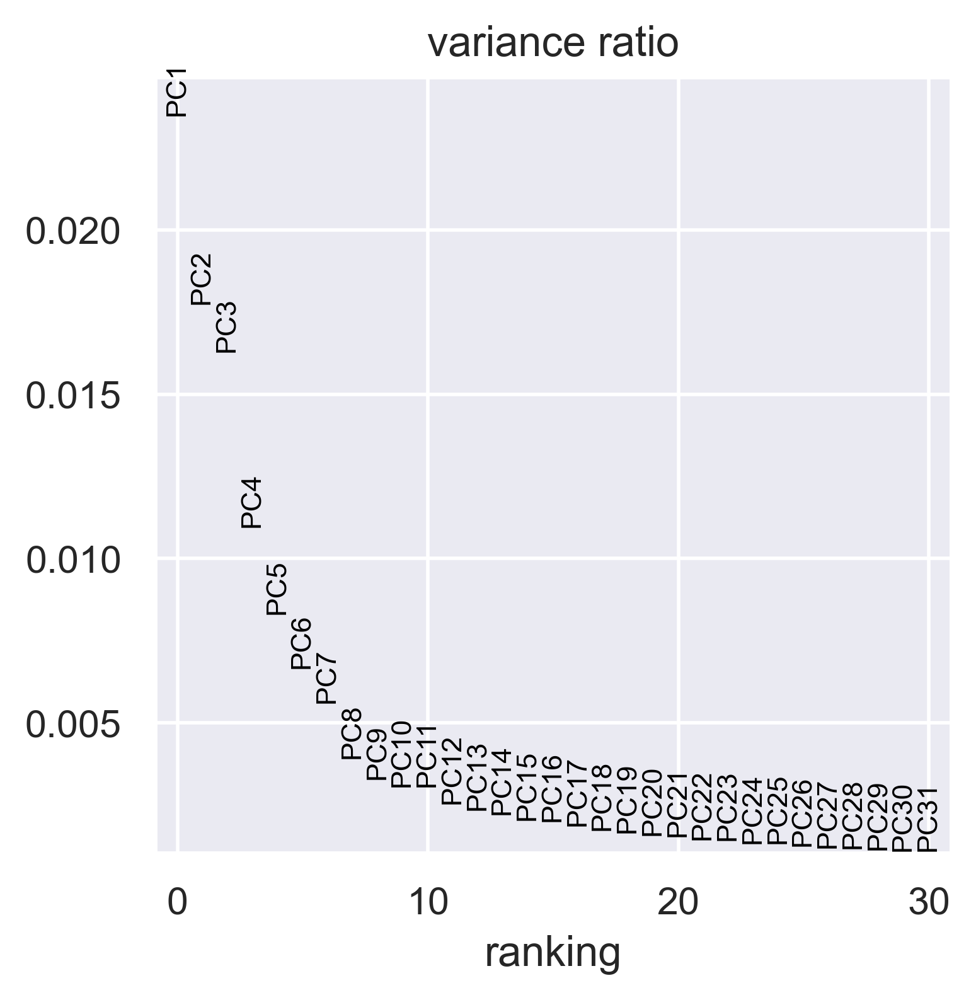

In [22]:
sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)

In [23]:
all_dataset.obsm['X_pca'].shape

(47008, 100)

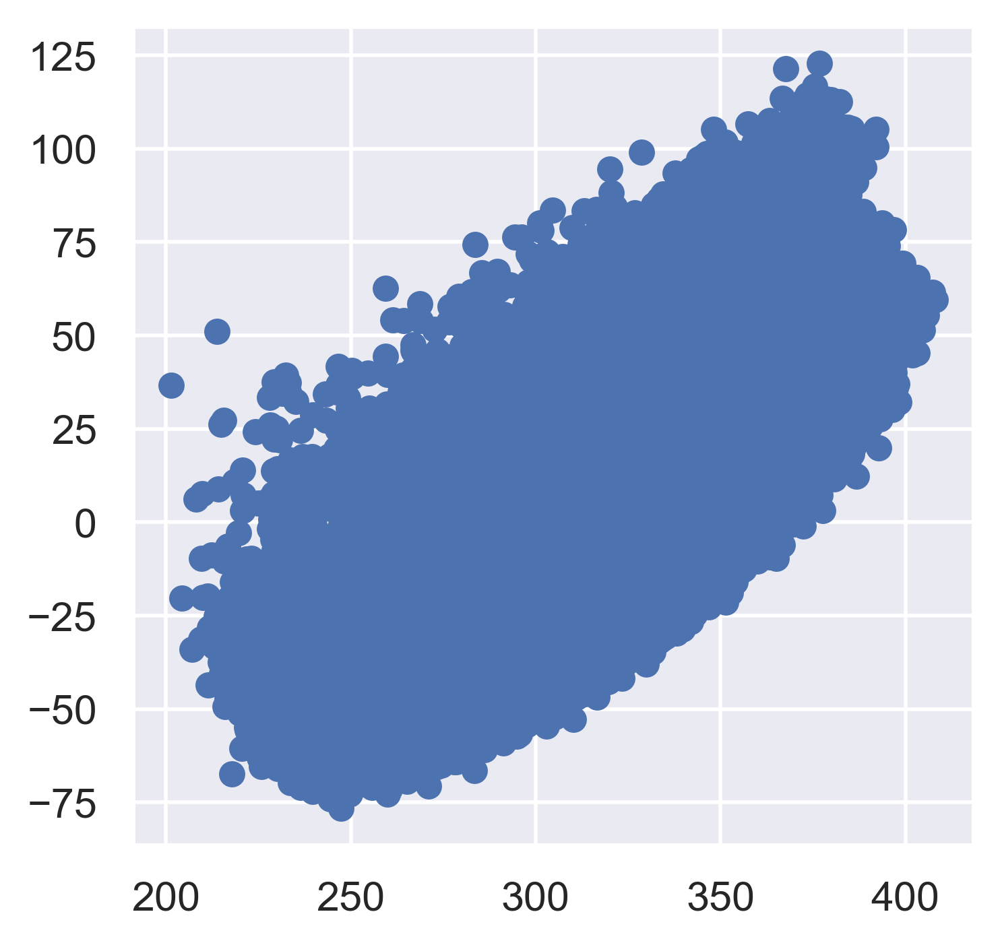

In [24]:
plt.scatter(all_dataset.obsm['X_pca'][:, 0], all_dataset.obsm['X_pca'][:, 1])

### 4. Computing the neighborhood graph and Embedding the neighborhood graph

In [25]:
sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)

In [26]:
sc.tl.umap(all_dataset)

In [27]:
all_dataset

AnnData object with n_obs × n_vars = 47008 × 12114
    obs: 'cell_type', 'dataset_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [28]:
sc.tl.leiden(all_dataset)

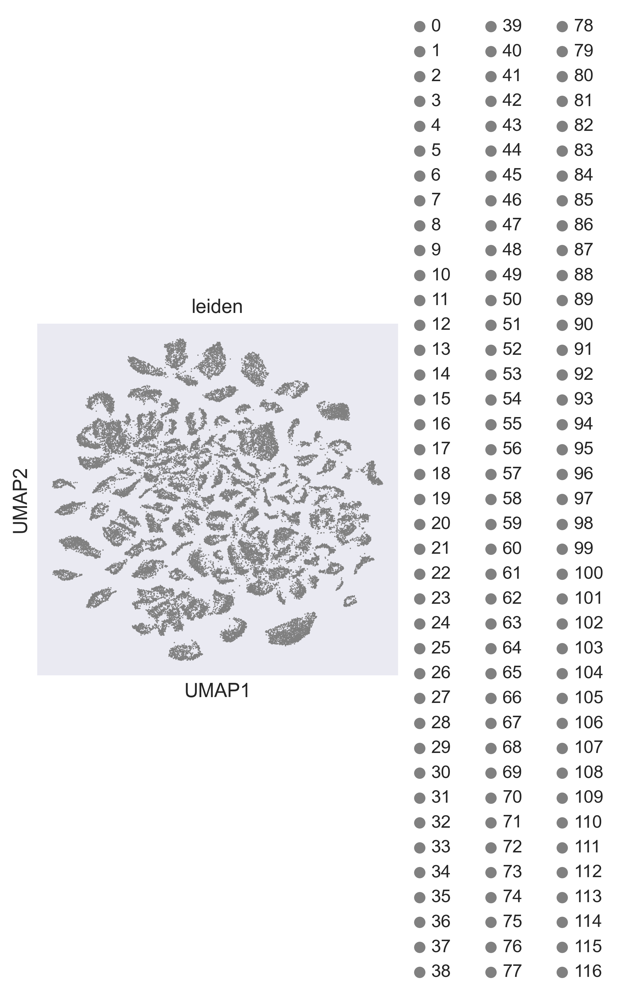

In [30]:
sc.pl.umap(all_dataset, color=['leiden'], save='before_batch_correct_umap_leiden.png')

In [31]:
all_dataset.write(os.path.join(result_dir, 'GSE157220_log2cpm1p_filtered.h5ad'))

In [32]:
all_dataset

AnnData object with n_obs × n_vars = 47008 × 12114
    obs: 'cell_type', 'dataset_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

### 6. Finding marker genes

In [33]:
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False)

In [34]:
top30 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8,9,...,107,108,109,110,111,112,113,114,115,116
0,LGALS4,JTB,SFN,S100A2,S100B,IFI27,FTL,ATP5L,COL6A2,PPDPF,...,PRSS3,NDUFAF6,NDUFS5,TGM2,RPL15,SPON2,EIF4EBP1,MIEN1,ADIRF,QPRT
1,GPX2,BASP1,S100A2,KRT14,MFSD12,IFI6,ALDH3A1,MRPL9,LGALS1,STARD10,...,OCIAD2,RPL8,TFPI2,MMP1,RPL18,LIMCH1,CMAS,CDC6,HPGD,MACROD2
2,EPCAM,NMB,SERINC2,KRT6A,SERPINE2,PRDX5,SLC25A6,TAGLN,COL1A1,XBP1,...,G0S2,ERBB2,NDUFS8,DKK3,RPS19,AMD1,PTHLH,G6PD,EPHB6,TMEM205
3,PRSS3,RAB25,RHOD,COL17A1,AP1S2,LY6E,HSPE1,TPM3,COL6A1,GATA3,...,LHX1,STAU1,TGM2,SLC16A3,RPS16,CCDC57,CAV2,ERBB2,CTSH,C3
4,MLEC,S100A16,BLCAP,C16orf74,TOMM7,ISG15,SRGN,NCL,COL1A2,METRN,...,YBX1,MIEN1,IFITM2,CXCL6,FBL,TMEM134,ANXA1,FTL,TNFAIP2,SLPI
5,KRT8,S100A14,PKP3,LAMB3,BACE2,C9orf3,NQO2,MRPL21,CALD1,SPTSSB,...,CAPN2,PHB,CYP24A1,BTF3,RPL28,MPC2,LSM1,AGR2,S100A2,PLTP
6,SLC12A2,NDUFS6,CSTA,FERMT1,POLR2F,KRT14,MLLT11,TMEM123,CALU,SLC9A3R1,...,SNX3,STARD10,ACAT1,TUBB6,RPL32,STEAP2,FDFT1,GTF3A,ELF3,JSRP1
7,ASCL2,C1orf61,C16orf74,KRT5,ATOX1,IFITM3,NME4,MRPS21,MYL6,SMARCD2,...,IGF2BP3,FAM84B,DIRAS3,PDPN,RPLP2,ZG16B,GIMAP4,MIB2,RPS19,MTX1
8,S100P,CMBL,CAPN1,SFN,HMG20B,PDLIM1,RPS23,RPL26,SPARC,VMP1,...,HMGA1,XBP1,AP1M2,SCG5,RPL23,MAZ,FERMT3,AKR1C2,SPOCD1,CYBA
9,ATP5D,HDGF,PDLIM1,ITGA6,SPARC,B2M,SQSTM1,DEK,TPI1,NPDC1,...,GCLM,ZSWIM7,GNG11,HMGN2,DPH3,DHCR24,PLEKHA5,TOMM40,GALNT1,CD40


In [35]:
common_marker_gene = pd.read_csv('selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker
marker_gene,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN


In [37]:
for cluster_id in top30:
    print('--------------------------------------------')
    print('Current cluster id: {}'.format(cluster_id))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

--------------------------------------------
Current cluster id: 0
        0         cell_type
2   EPCAM  Epithelial Cells
5    KRT8  Epithelial Cells
15  KRT18  Epithelial Cells
15  KRT18  Epithelial Cells
--------------------------------------------
Current cluster id: 1
Empty DataFrame
Columns: [1, cell_type]
Index: []
--------------------------------------------
Current cluster id: 2
        2         cell_type
10   KRT5  Epithelial Cells
16  FSCN1                DC
--------------------------------------------
Current cluster id: 3
      3         cell_type
7  KRT5  Epithelial Cells
--------------------------------------------
Current cluster id: 4
Empty DataFrame
Columns: [4, cell_type]
Index: []
--------------------------------------------
Current cluster id: 5
        5         cell_type
12   KRT5  Epithelial Cells
21  KRT17  Epithelial Cells
--------------------------------------------
Current cluster id: 6
Empty DataFrame
Columns: [6, cell_type]
Index: []
---------------------

In [38]:
all_dataset.obs

,cell_type,dataset_id,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden
AAACCTGAGACATAAC-1-18,Cancer Cells,pan_cancer_07,4318,4318,999999.9375,37968.406250,3.796841,54
AACGTTGTCACCCGAG-1-18,Cancer Cells,pan_cancer_07,5200,5200,1000000.0000,34923.253906,3.492326,54
AACTGGTAGACACGAC-1-18,Cancer Cells,pan_cancer_07,4004,4004,999999.9375,31946.083984,3.194608,54
AACTGGTAGGGCTTGA-1-18,Cancer Cells,pan_cancer_07,4295,4295,999999.9375,29955.068359,2.995507,54
AACTGGTAGTACTTGC-1-18,Cancer Cells,pan_cancer_07,4842,4842,1000000.0000,60400.332031,6.040033,54
...,...,...,...,...,...,...,...,...
c4708,Cancer Cells,pan_cancer_07,4084,4084,1000000.0000,36420.785156,3.642078,83
c4714,Cancer Cells,pan_cancer_07,3791,3791,1000000.0000,39881.480469,3.988148,83
c4722,Cancer Cells,pan_cancer_07,3343,3343,1000000.0000,15619.915039,1.561991,83
c4735,Cancer Cells,pan_cancer_07,4052,4052,999999.9375,24566.597656,2.456660,83


### 7. Removing clusters contain marker genes of other cell types

In [42]:
# remove clusters that contain marker genes of other cell types
removed_cluster_id = [2, 7, 8, 9, 12, 14, 19, 21, 32, 34, 35, 36, 40, 43, 45, 47, 51, 53, 55, 56, 59, 64, 65, 66, 69, 73, 74, 75, 77, 78, 80, 82, 84, 90, 92, 93, 94, 95, 101, 113, 115, 116]
removed_cluster_id = [str(i) for i in removed_cluster_id]

In [43]:
all_dataset = all_dataset[~all_dataset.obs.leiden.isin(removed_cluster_id), :].copy()
all_dataset

AnnData object with n_obs × n_vars = 30853 × 12114
    obs: 'cell_type', 'dataset_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [44]:
np.unique(all_dataset.obs.leiden)

array(['0', '1', '10', '100', '102', '103', '104', '105', '106', '107',
       '108', '109', '11', '110', '111', '112', '114', '13', '15', '16',
       '17', '18', '20', '22', '23', '24', '25', '26', '27', '28', '29',
       '3', '30', '31', '33', '37', '38', '39', '4', '41', '42', '44',
       '46', '48', '49', '5', '50', '52', '54', '57', '58', '6', '60',
       '61', '62', '63', '67', '68', '70', '71', '72', '76', '79', '81',
       '83', '85', '86', '87', '88', '89', '91', '96', '97', '98', '99'],
      dtype=object)

In [48]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4", "CXCL13", "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2", 
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                 "FOXP3", "CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T
                 "CX3CR1", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "XCL1", "KLRD1", "SAMD3", "TBX21"]  # NK

In [54]:
marker_genes2 = ["BANK1", "CD19", "CD22", "CD79A", "FCRL5", "MS4A1", "SLAMF7", # B Cells
                 "CLEC10A", "LAMP3", "CD80", "CD83", "IRF8", "MZB1", "CD40", # DC
                 "CLDN5", "ENG", "PLVAP", "VWF", # Endothelial Cells
                 "COL1A1", "COL1A2", "COL3A1", "MYL9",  # Fibroblasts
                 "AIF1", "CD14", "CD163", "CD68", "CTSB", "FCGR2A", "FCGR3B", "LYZ", "FCGR3A", # Macrophages
                 # "MS4A2", # Mast Cells
                 "CFLAR", "CSF3R", "CXCR2", "FPR1", "S100A8", "S100A9", "SLC25A37", # Neutrophils
                 "CDH1", "EPCAM", "KRT18", "KRT19", 'KRT5', 'KRT8']  # Epithelial cells

In [50]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes1_dotplot.png', dendrogram=True)

In [55]:
sc.pl.dotplot(all_dataset, marker_genes2, groupby='leiden', save='marker_genes2_dotplot.png', dendrogram=True)

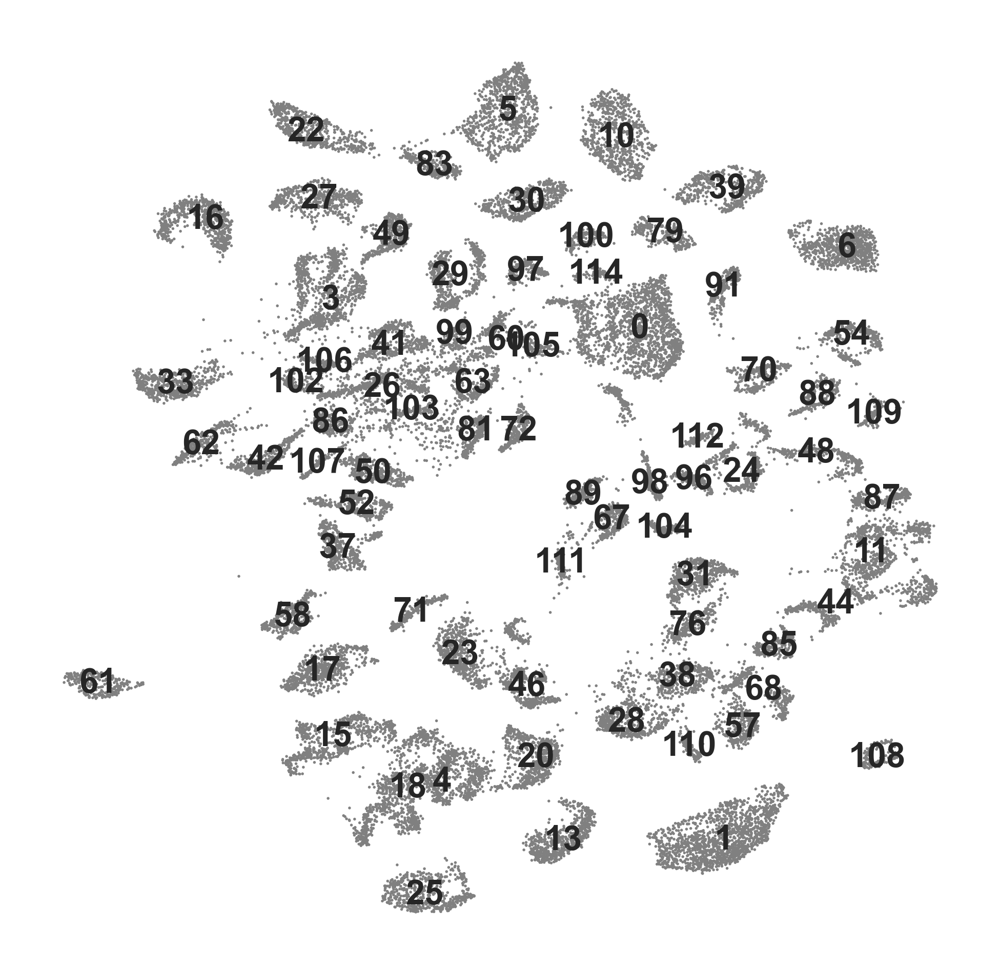

In [56]:
# plt.figure(figsize=(15, 15))
rcParams['figure.figsize'] = 6, 6
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='medium', 
           title='', frameon=False, save='.png')

In [57]:
all_dataset

AnnData object with n_obs × n_vars = 30853 × 12114
    obs: 'cell_type', 'dataset_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [59]:
all_dataset.write(os.path.join(result_dir, 'pan_cancer_07_GSE157220_log2cpm1p_filtered.h5ad'))